- This notebook will prepare the main Figures for the spatial distribution of nonNeuronal cells. 

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import anndata 
import scanpy as sc
sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi = 180, dpi_save = 300, frameon = False, figsize = (4,4), fontsize=8,facecolor = 'white')



- Utility function for spatial plotting

In [2]:
def plot_cluster_scdata(scdata,cmap,all_clusters,clusters=[1,2],bg_color = 'gray',bg_pt_size = 5, point_sz_map = None, transpose=1,flipx=1,flipy=1,hue_input = 'leiden' , ax = None,use_seaborn = False,show_title = True):
    """
    plot spatial location of cell cluster using either seaborn or matplotlib
    use seaborn for individual clusters
    use matplotlib scatter function to visualize all clusters
    cmap - dictionary that has color of each cluster  used in umap
    """
    fig = None
    if not ax:
     fig,ax = plt.subplots(figsize=(15, 15),)# facecolor="black")

    
    if use_seaborn:
        x,y,hue = 'x', 'y',hue_input
        sns.scatterplot(x=x, y=y, data=scdata.obs, 
                        s=bg_pt_size, markers=dict(marker_edge_color='none'),
                        rasterized=True,
                        ax=ax,c= bg_color)
    else: # use matplotlib
        x,y = (np.array(scdata.obs[['x', 'y']])*[flipx,flipy])[:,::transpose].T
        ax.scatter(x, y, c=bg_color, s = bg_pt_size, marker='.')
        
    for cluster in clusters:
        clst_idx = all_clusters.index(cluster)
        cluster_ = str(cluster)
        inds = scdata.obs[hue_input] == cluster_
        
        #col = cmap[int(clst_idx) % len(cmap)]
        col = cmap[cluster_] # cmap is dictionary
        point_sz = point_sz_map[cluster_] # point size dictionary
        if use_seaborn:
            sns.scatterplot(x=x, y=y, data=scdata.obs[inds], 
                        s=point_sz, markers=dict(marker_edge_color=col),
                        rasterized=True,
                        ax=ax,c= col)
            if show_title:
                ax.set_title(f'cluster {cluster_}',fontsize = 7, y= 1)
        else:
            x_ = x[inds]
            y_ = y[inds]
            ax.scatter(x_, y_, c=col, s= point_sz, marker='.',label = cluster_)
        
        
    
    # ax.set_xlim([x.min(),x.max()])
    # ax.set_ylim([y.min(),y.max()])
    ax.grid(False)
    ax.axis("off")
    ax.axis("equal")
    if fig:
        ax.legend( loc = 'lower center', ncol = len(clusters)//3,markerscale = 12, title = 'Clusters',facecolor = 'black',
            labelcolor = 'white')
        ax.set_title(np.unique(scdata.obs['sample'])[0])
    else:
        # ax.legend( loc = 'lower center')
        pass
        
    ax.autoscale(enable=True, tight=True)
    
   

In [3]:
def rotate(spatial_x,deg):
    """
    spatial_X: Nx2 matrix
    deg: rotation degree in radian
    
    """
    deg = np.deg2rad(deg)
    rotation_mat = np.array([[np.cos(deg),-1*np.sin(deg)],
                            [np.sin(deg),np.cos(deg)]])
    return np.matmul(spatial_x,rotation_mat)

- Load all MERFISH data

In [ ]:
%%time

# load 1311 posterior 
Donor_1311_posterior_adata  = anndata.read_h5ad(r'./../../MERFISH_adata_QC/mapmycell_annotated_adata/MER2_Gpe_Gpi_CaPu_1311__MERFISH_annotated.h5ad')
print('load 1311 posterior .....')

# # load 2427 posterior 
Donor_2427_posterior_adata = anndata.read_h5ad(r'./../../MERFISH_adata_QC/mapmycell_annotated_adata/MER4_Gpe_Gpi_2724__MERFISH_annotated.h5ad')
print('load 2427 posterior .....')

# # load 2427 anterior 
Donor_2427_anterior_adata = anndata.read_h5ad(r'./../../MERFISH_adata_QC/mapmycell_annotated_adata/MER1_CaPuNAC_2427__MERFISH_annotated.h5ad')
print('load 2427 anterior .....')

# # load 3924 anterior 
Donor_3924_anterior_adata = anndata.read_h5ad(r'./../../MERFISH_adata_QC/mapmycell_annotated_adata/MER5_CaPuNAc_3924__MERFISH_annotated.h5ad')
print('load 3924 anterior  .....')

load 1311 posterior .....
load 2427 posterior .....
load 2427 anterior .....
load 3924 anterior  .....
CPU times: user 1min 21s, sys: 15 s, total: 1min 36s
Wall time: 1min 43s


- Concatente the data

- Make sure the same order of genes is used in all samples and replace the count with raw counts. 

In [5]:
# make sure the same order of genes is used in all samples  and replace count with raw counts
common_gns = np.array(Donor_2427_posterior_adata.var_names)
Donor_1311_posterior_adata.X = Donor_1311_posterior_adata.layers['X_raw']
Donor_1311_posterior_adata = Donor_1311_posterior_adata[:,common_gns].copy()
Donor_1311_posterior_adata.obsm['X_spatial'] = Donor_1311_posterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_1311_posterior_adata.obsm else Donor_1311_posterior_adata.obsm['X_spatial']

Donor_2427_posterior_adata.X = Donor_2427_posterior_adata.layers['X_raw']
Donor_2427_posterior_adata = Donor_2427_posterior_adata[:,common_gns].copy()
Donor_2427_posterior_adata.obsm['X_spatial'] = Donor_2427_posterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_2427_posterior_adata.obsm else Donor_2427_posterior_adata.obsm['X_spatial']

Donor_2427_anterior_adata.X = Donor_2427_anterior_adata.obsm['X_raw']
Donor_2427_anterior_adata = Donor_2427_anterior_adata[:,common_gns].copy()
Donor_2427_anterior_adata.obsm['X_spatial'] = Donor_2427_anterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_2427_anterior_adata.obsm else Donor_2427_anterior_adata.obsm['X_spatial']

Donor_3924_anterior_adata.X = Donor_3924_anterior_adata.layers['X_raw']
Donor_3924_anterior_adata = Donor_3924_anterior_adata[:,common_gns].copy()
Donor_3924_anterior_adata.obsm['X_spatial'] = Donor_3924_anterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_3924_anterior_adata.obsm else Donor_3924_anterior_adata.obsm['X_spatial']

In [6]:
# concatenate the data
adata = anndata.concat([Donor_1311_posterior_adata,Donor_2427_posterior_adata,Donor_2427_anterior_adata,Donor_3924_anterior_adata],
                       label = 'samples',
                        keys= ['Donor_1311_posterior','Donor_2724_posterior','Donor_2724_anterior','Donor_3924_anterior'],
                        fill_value=0,
                        join='outer',
                        merge='same' ,
                        index_unique='_' # make the cell index unique
                        ) 


**NOTE:** The function `anndata.concat` does not concatenate values in layers, so we need to define it again

In [7]:
## set the count to raw count 
adata.layers['X_raw'] = adata.X.copy()

### 1. Spatial map between Oligo subtypes 

- Load the contour for the spatial modules

In [ ]:
donor_1311_posterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_1311_posterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_2427_posterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_2427_posterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_2427_anterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_2427_anterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_3924_anterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_3924_anterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

- Define the colormap and define point size

In [9]:
cluster_cmap = np.load(r'./cluster_cmap_final_updated_9172025.npy',allow_pickle=True).item()
all_clusters = np.unique(adata.obs['Group_name']).tolist()
clusters_curated = [ 

# +++++++++++++ Oligo +++++++++++++++++++++++
'ImOligo','Oligo OPALIN', 'Oligo PLEKHG1',
'COP',
'OPC',
 
# # glia (Astro-Ependy-Immune)
 'Astrocyte',
  'Ependymal',
  'ImAstro',
 'B cells',
 'BAM',
 'Endo',
'VLMC',
'Pericyte',
 'SMC',

# # # ++++++++++++++++ Gp cells  +++++++++++++++++++
 'GPe MEIS2-SOX6 GABA',
 'GPe SOX6-CTXND1 GABA',
 'GPe-NDB-SI LHX6-LHX8-GBX1 GABA',
 'GPi Core',
 'GPi Shell',
 'GPin-BF Cholinergic GABA',

# # +++++++++++++++++ MSN ++++++++++++++++++++++++++++++++
    'STR D1D2 Hybrid MSN',
    'STRd D2 StrioMat Hybrid MSN',
    'STRv D1 NUDAP MSN',
    'STRd D2 Striosome MSN',
    'STRd D2 Matrix MSN',
    'STRd D1 Striosome MSN',
    'STRd D1 Matrix MSN',
    'STRv D1 MSN',
    'STRv D2 MSN'
    

    ]

remaining_clusters  = list(set(all_clusters).difference(clusters_curated))

all_clusters = remaining_clusters + clusters_curated

point_sz_map = { 'Oligo OPALIN': 0.05,
                 'Oligo PLEKHG1': 0.2,
                  'COP':0.5,
                  'ImOligo':0.2,
                  'OPC': 0.5,
                'STR D1D2 Hybrid MSN': 2,
                'STRd D2 StrioMat Hybrid MSN': 2,
                'STRv D1 NUDAP MSN':2,
                 'STRd D2 Striosome MSN':2,
                 'STRd D1 Striosome MSN':2,
                 'STRd D2 Matrix MSN':2,
                 'STRd D1 Matrix MSN':2,
                 'STRv D1 MSN':2,
                 'STRv D2 MSN':2,
                  'GPi Core':4,
                  'GPi Shell':4,
                   'GPe SOX6-CTXND1 GABA':2,
                   'GPe MEIS2-SOX6 GABA':2,
                   'GPe-NDB-SI LHX6-LHX8-GBX1 GABA':2,
                    'GPin-BF Cholinergic GABA':2,
                   
                    # glia (Astro-Ependy-Immune)
                    'Astrocyte':0.2,
                    'Ependymal':0.2,
                    'ImAstro':0.2,
                    'B cells':0.2,
                    'BAM':0.2,
                    'Endo':0.2,
                    'VLMC': 1,
                     'Pericyte': 0.5,
                     'SMC': 1,
                     'Microglia':1

                    
                 }

point_sz_map.update({clst:2 for clst in remaining_clusters})


- Identify the non-neuronal cell types 

In [10]:
keep = adata.obs['Neighborhood_name'].isin(['Nonneuron'])
nonneuron_celltypes = np.unique(adata[keep].obs['Group_name'])
allnonNeuron_clusters = [clst for clst in all_clusters if clst in nonneuron_celltypes]

In [12]:
import seaborn as sns
import matplotlib.patches as patches
import os
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 

adata.obs[['x','y']] = adata.obsm['X_spatial'].copy()
figsize_scale = 8e3

dx_list = []
dy_list = []
samples = np.unique(adata.obs['samples'])
for i,sample in enumerate(samples):
    cond = adata.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = adata[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample]) # since rotation is could change the xy limit, perform rotation to get accurate estiamte

    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    dx_list += [dx/figsize_scale]
    dy_list += [dy/figsize_scale]
dx_max = np.max(dx_list)  
dy_max = np.max(dy_list)  
print(f'max-width:{dx_max}, max-height:{dy_max}')

max-width:3.4967735624804646, max-height:4.602798834741115


#### A. AP19a (Donor 2724 anterior): Oligo_OPALIN vs Oligo_PLEKHG1 spatial map

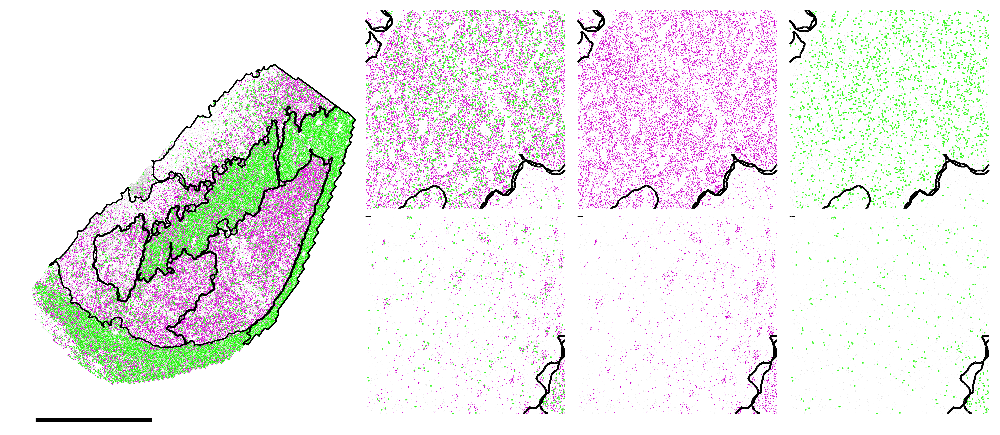

In [32]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 

nobox = True
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
# backgd_sz = {'Donor_1311_posterior':0.025,'Donor_2427_anterior':0.05,'Donor_2427_posterior':0.03,'Donor_3924_anterior':0.05}
backgd_sz = {'Donor_1311_posterior':0.005,'Donor_2724_anterior':0.005,'Donor_2724_posterior':0.005,'Donor_3924_anterior':0.005}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}


all_clusters_plot = ['Oligo OPALIN','Oligo PLEKHG1']
point_sz_map_cp = copy.deepcopy(point_sz_map)
point_sz_map_cp[all_clusters_plot[0]] = 7*point_sz_map_cp[all_clusters_plot[0]]
point_sz_map_cp[all_clusters_plot[-1]] = 5*point_sz_map_cp[all_clusters_plot[-1]]

fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
bbox = fig.get_tightbbox()
ax = None

samples = ['Donor_2724_anterior']
# samples = ['Donor_2427_posterior','Donor_1311_posterior']
figure_title = 'Oligo_OPALIN_PLEKHG1'
transformed_Xsample = {}
transformed_module_cnt = {}
transformed_striocnt = {}

for sampleIdx,sample in enumerate(samples):
    cond = adata.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = adata[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample])
    cnt = copy.deepcopy(sptial_module_dict[sample])
    strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
    
    for label_ in cnt:
        if isinstance(cnt[label_],list):
            for i in range(len(cnt[label_])):
                cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
        else:   
            cnt[label_] = rotate(cnt[label_],rot_deg[sample])
    for idx in range(len(strio_cnt)):
        strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

    if reverse_coord[sample]:
        X_sample = X_sample[:,::-1]
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = cnt[label_][i][:,::-1]
            else:
                cnt[label_] = cnt[label_][:,::-1]
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = strio_cnt[idx][:,::-1]

    adata.obs.loc[cond,['x','y']] = X_sample.copy()
    # save the transformations 

    transformed_Xsample[sample] = X_sample.copy()
    transformed_module_cnt[sample] = copy.deepcopy(cnt)
    transformed_striocnt[sample] = copy.deepcopy(strio_cnt)


    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    if ax != None:
        bbox = ax.get_position()
    dx = dx/figsize_scale
    dy = dy/figsize_scale
    # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
    dx_frac = dx/fig.get_figwidth()
    dy_frac = dy/fig.get_figheight()
    width_gap = 1
    if sampleIdx < 2:
        width_gap = 0.9
    elif sampleIdx < 3:
        width_gap = 0.95

    ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
    plot_cluster_scdata(adata[cond],cluster_cmap,all_clusters = all_clusters_plot,clusters = all_clusters_plot,bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map_cp, transpose=1,flipx=1,flipy=1,hue_input = 'Group_name' , ax = ax,use_seaborn = True,show_title = False )

    # add the outregion outlines 
    for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
        if label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 1, c = 'k')
            else:
                ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 1, c = 'k')
    # add the striosome contour outline
    # for cnt in strio_cnt:
    #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

    # Set the axis limits 
    xmax, ymax = X_sample.max(axis=0)
    xmin, ymin = X_sample.min(axis=0)
    # ax.set_xlim([xmin,xmax])
    ax.set_ylim([ymin,ymax + 3500])
    # add scale bar
    # add scale bar
    if sample == 'Donor_2724_anterior':
        scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
    else:    
        scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
    ax.add_patch(scalebar)

    # put zoom-in box on the spatial plot 
    if sample == 'Donor_3924_anterior':
        zoom_bbox = patches.Rectangle([-10000, 10000],11000,-11000,color  ='k', fill = False,lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox)
    else: # if sample == 'Donor_2724_anterior':
        zoom_bbox_1 = patches.Rectangle([1000,-1500],-4000,-4000,color  ='k', fill = False, lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox_1)

        zoom_bbox_2 = patches.Rectangle([-500,-9000],-4000,-4000,color  ='k', fill = False, lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox_2)


    if invert_xaxis[sample]:
        ax.invert_xaxis()
    
    if invert_yaxis[sample]:
        ax.invert_yaxis()
    # ax.set_axis_on()
    # add axes for zoomin view 
    # have 6 zoom in panels
    if sampleIdx == len(samples) - 1:
        bbox = ax.get_position()
        # Top row
        zoom1_ax = fig.add_axes([bbox.xmin + 0.97*bbox.width,bbox.ymin + 0.6*bbox.height, 0.55*bbox.width, 0.55*bbox.height])
        zoom2_ax = fig.add_axes([bbox.xmin + 1.55*bbox.width, bbox.ymin + 0.6*bbox.height, 0.55*bbox.width, 0.55*bbox.height])
        zoom3_ax = fig.add_axes([bbox.xmin + 2.13*bbox.width, bbox.ymin + 0.6*bbox.height, 0.55*bbox.width, 0.55*bbox.height])

        # bottom row
        zoom4_ax = fig.add_axes([bbox.xmin + 0.97*bbox.width,bbox.ymin + 0.03*bbox.height, 0.55*bbox.width, 0.55*bbox.height])
        zoom5_ax = fig.add_axes([bbox.xmin + 1.55*bbox.width, bbox.ymin + 0.03*bbox.height, 0.55*bbox.width, 0.55*bbox.height])
        zoom6_ax = fig.add_axes([bbox.xmin + 2.13*bbox.width, bbox.ymin + 0.03*bbox.height, 0.55*bbox.width, 0.55*bbox.height])
        
        # Plot the zoom-in data 
        for bbox_idx,bbox_ in enumerate([zoom_bbox_1, zoom_bbox_2]):
            # get the limit 
            X_lim,Y_lim = np.array(bbox_.get_bbox()).T
            xmin,xmax = tuple(X_lim) if X_lim[0] < X_lim[1] else tuple(X_lim[::-1])
            ymin,ymax = tuple(Y_lim) if Y_lim[0] < Y_lim[1] else tuple(Y_lim[::-1])

            sample = 'Donor_2724_anterior'
            sample_cond = adata.obs['samples'] == sample
            X_sample = transformed_Xsample[sample].copy()
            cond1 = (X_sample[:,0] > xmin) & (X_sample[:,0] < xmax)
            cond2 = (X_sample[:,1] > ymin) & (X_sample[:,1]  < ymax)
            # increase the size of the point 
            point_sz_map_cp = copy.deepcopy(point_sz_map)
            for clst in all_clusters_plot:
                point_sz_map_cp[clst] = 7*point_sz_map_cp[clst]
            zoom_ax_set = [zoom1_ax, zoom2_ax, zoom3_ax] if bbox_idx == 0 else [zoom4_ax, zoom5_ax, zoom6_ax]
            for ax_,clst_set in zip(zoom_ax_set,[all_clusters_plot,all_clusters_plot[0],all_clusters_plot[-1]]):
                clst_set = [clst_set] if not isinstance(clst_set, list) else clst_set
                plot_cluster_scdata(adata[sample_cond][cond1 & cond2],cluster_cmap,all_clusters = clst_set,clusters = clst_set,bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map_cp, transpose=1,flipx=1,flipy=1,hue_input = 'Group_name' , ax = ax_,use_seaborn = True,show_title = False )
                # add the box ontop to highlight the bbox
                zbbox = patches.Rectangle(list(X_sample[cond1 & cond2].min(axis=0)),*tuple(np.ptp(X_sample[cond1 & cond2],axis = 0)),color  ='k', fill = False, lw = 2, ls = '--')
                if not nobox:
                    ax_.add_patch(zbbox)

                # add the outregion outlines 
                cnt = transformed_module_cnt[sample]
                for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
                    if label_ in cnt:
                        if isinstance(cnt[label_],list):
                            for i in range(len(cnt[label_])):
                                cnt_cond1 = (cnt[label_][i][:,0] > xmin) & (cnt[label_][i][:,0] < xmax)
                                cnt_cond2 = (cnt[label_][i][:,1] > ymin) & (cnt[label_][i][:,1]  < ymax)
                                ax_.scatter(cnt[label_][i][cond1 & cond2,0],cnt[label_][i][cond1 & cond2,1], s = 1e-1, c = 'k')
                        else:
                            cnt_cond1 = (cnt[label_][:,0] > xmin) & (cnt[label_][:,0] < xmax)
                            cnt_cond2 = (cnt[label_][:,1] > ymin) & (cnt[label_][:,1]  < ymax)
                            ax_.scatter(cnt[label_][cnt_cond1 & cnt_cond2,0],cnt[label_][cnt_cond1 & cnt_cond2,1], s = 1e-1, c = 'k')

                if invert_xaxis[sample]:
                    ax_.invert_xaxis()
                if invert_yaxis[sample]:
                    ax_.invert_yaxis()


    # ax.set_aspect('equal', adjustable ='datalim')
    if False:#sampleIdx == 0:
        # create axis to put the title and text 
        bbox = ax.get_position()
        legend_ax = fig.add_axes([bbox.xmin + 0.3*bbox.width, bbox.ymin + 1.03*bbox.height, 3.5*bbox.width, 0.3*bbox.height])
        # add circle patche and text for the 3 cell types 
        for clst_i, clst in enumerate(['STRd D1 Striosome MSN','STRd D1 Matrix MSN','STRv D1 MSN']):
            yfactor = -0.5 if clst == 'STRv D1 MSN' else 0
            xfactor = 1 if clst == 'STRv D1 MSN' else 0
            color_rec = patches.Circle([-4.5 + 5*(clst_i - xfactor),0.72 + yfactor],0.2, color = cluster_cmap[clst])
            legend_ax.add_patch(color_rec)
            legend_ax.text((-4.5 + 5*(clst_i-xfactor)) + 0.3, 0.72 + yfactor, f'{clst}', fontsize = 25, color = 'k', va = 'center')
        legend_ax.set_aspect('equal',adjustable='datalim')
        # legend_ax.set_ylim(-1.3,1)
        legend_ax.set_axis_off()
            


    # file_name = '_'.join([x for x in f'{cluster_}'.replace(' ','_').split('-') ])
file_name = '2724_anterior_Oligo_OPALIN_PLEKHG1_nobox'
if nobox:
    file_name = file_name + '_nobox'
plt.savefig(r'./figures/figure4/main_nonneuronalFig' + os.sep + file_name + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/figure4/main_nonneuronalFig' + os.sep + file_name + '.tif',bbox_inches = 'tight')

plt.show()

#### B. AP34a (Donor 1311 Posterior): 'Oligo OPALIN' vs 'Oligo PLEKHG1' spatial map

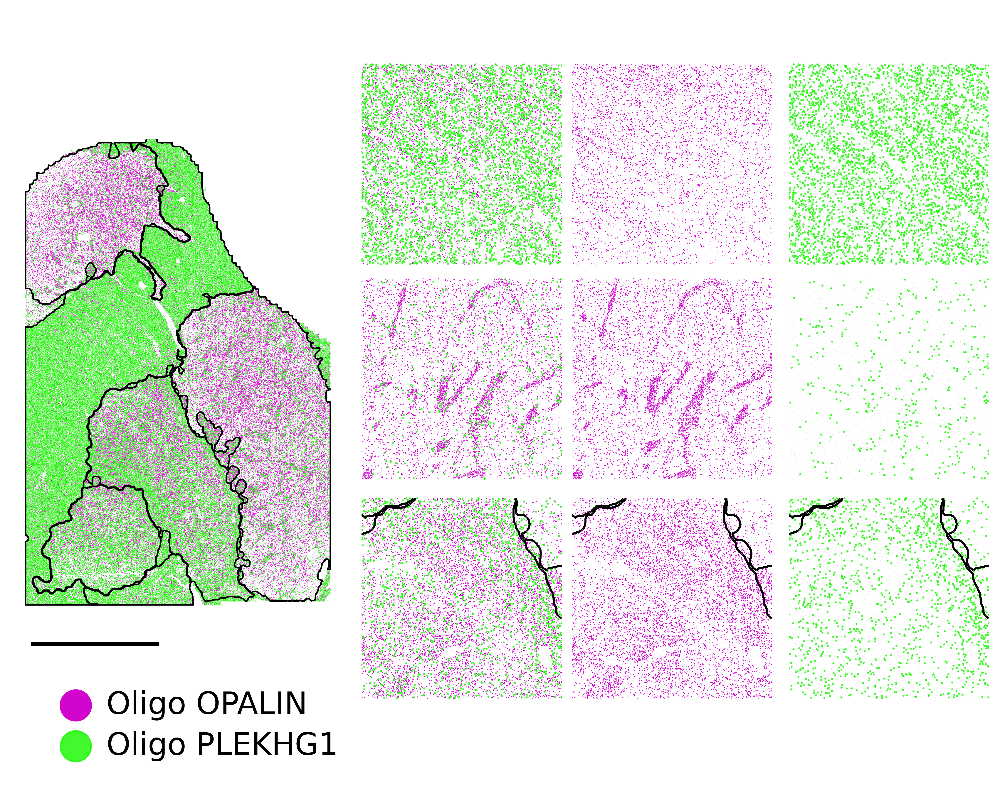

In [16]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 
import matplotlib as mpl
mpl.rcParams['font.size'] = 20

nobox = True

rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
# backgd_sz = {'Donor_1311_posterior':0.025,'Donor_2427_anterior':0.05,'Donor_2427_posterior':0.03,'Donor_3924_anterior':0.05}
backgd_sz = {'Donor_1311_posterior':0.005,'Donor_2724_anterior':0.005,'Donor_2724_posterior':0.005,'Donor_3924_anterior':0.005}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}


all_clusters_plot = ['Oligo OPALIN','Oligo PLEKHG1']
point_sz_map_cp = copy.deepcopy(point_sz_map)
point_sz_map_cp[all_clusters_plot[0]] = 3*point_sz_map_cp[all_clusters_plot[0]]
point_sz_map_cp[all_clusters_plot[-1]] = 3*point_sz_map_cp[all_clusters_plot[-1]]

fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
bbox = fig.get_tightbbox()
ax = None

samples = ['Donor_1311_posterior']
# samples = ['Donor_2427_posterior','Donor_1311_posterior']
figure_title = 'Oligo_OPALIN_PLEKHG1'
transformed_Xsample = {}
transformed_module_cnt = {}
transformed_striocnt = {}

for sampleIdx,sample in enumerate(samples):
    cond = adata.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = adata[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample])
    cnt = copy.deepcopy(sptial_module_dict[sample])
    strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
    
    for label_ in cnt:
        if isinstance(cnt[label_],list):
            for i in range(len(cnt[label_])):
                cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
        else:   
            cnt[label_] = rotate(cnt[label_],rot_deg[sample])
    for idx in range(len(strio_cnt)):
        strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

    if reverse_coord[sample]:
        X_sample = X_sample[:,::-1]
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = cnt[label_][i][:,::-1]
            else:
                cnt[label_] = cnt[label_][:,::-1]
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = strio_cnt[idx][:,::-1]

    adata.obs.loc[cond,['x','y']] = X_sample.copy()
    # save the transformations 

    transformed_Xsample[sample] = X_sample.copy()
    transformed_module_cnt[sample] = copy.deepcopy(cnt)
    transformed_striocnt[sample] = copy.deepcopy(strio_cnt)


    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    if ax != None:
        bbox = ax.get_position()
    dx = dx/figsize_scale
    dy = dy/figsize_scale
    # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
    dx_frac = dx/fig.get_figwidth()
    dy_frac = dy/fig.get_figheight()
    width_gap = 1
    if sampleIdx < 2:
        width_gap = 0.9
    elif sampleIdx < 3:
        width_gap = 0.95

    ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
    plot_cluster_scdata(adata[cond],cluster_cmap,all_clusters = all_clusters_plot,clusters = all_clusters_plot,bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map_cp, transpose=1,flipx=1,flipy=1,hue_input = 'Group_name' , ax = ax,use_seaborn = True,show_title = False )
    
    # add the outregion outlines 
    for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
        if label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 1, c = 'k')
            else:
                ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 1, c = 'k')
    # add the striosome contour outline
    # for cnt in strio_cnt:
    #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

    # Set the axis limits 
    xmax, ymax = X_sample.max(axis=0)
    xmin, ymin = X_sample.min(axis=0)
    # ax.set_xlim([xmin,xmax])
    ax.set_ylim([ymin,ymax + 3500])
    # add scale bar
    # add scale bar
    if sample == 'Donor_2724_anterior':
        scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
    else:    
        scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
    ax.add_patch(scalebar)
    
    

    # put zoom-in box on the spatial plot 
    if sample == 'Donor_3924_anterior':
        zoom_bbox = patches.Rectangle([-10000, 10000],11000,-11000,color  ='k', fill = False,lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox)
    else: # if sample == 'Donor_2724_anterior':
        # this is in the Pu
        zoom_bbox_1 = patches.Rectangle([-5000,-1500],-4000,-4000,color  ='k', fill = False, lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox_1)
        # this is in the internal-capasule 
        zoom_bbox_2 = patches.Rectangle([5000,5000],4000,-4000,color  ='k', fill = False, lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox_2)
        # this is in the GPe
        zoom_bbox_3 = patches.Rectangle([-4000,5000],4000,-4000,color  ='k', fill = False, lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox_3)

    if invert_xaxis[sample]:
        ax.invert_xaxis()
    
    if invert_yaxis[sample]:
        ax.invert_yaxis()
    # ax.set_axis_on()
    # add axes for zoomin view 
    # if not nobox:
    # have 6 zoom in panels
    if sampleIdx == len(samples) - 1:
        bbox = ax.get_position()
        # Top row
        zoom1_ax = fig.add_axes([bbox.xmin + 1.05*bbox.width,bbox.ymin + 0.65*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
        zoom2_ax = fig.add_axes([bbox.xmin + 1.68*bbox.width, bbox.ymin + 0.65*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
        zoom3_ax = fig.add_axes([bbox.xmin + 2.33*bbox.width, bbox.ymin + 0.65*bbox.height, 0.6*bbox.width, 0.6*bbox.height])

        # middle row
        zoom4_ax = fig.add_axes([bbox.xmin + 1.05*bbox.width,bbox.ymin + 0.23*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
        zoom5_ax = fig.add_axes([bbox.xmin + 1.68*bbox.width, bbox.ymin + 0.23*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
        zoom6_ax = fig.add_axes([bbox.xmin + 2.33*bbox.width, bbox.ymin + 0.23*bbox.height, 0.6*bbox.width, 0.6*bbox.height])

        # bottom row
        zoom7_ax = fig.add_axes([bbox.xmin + 1.05*bbox.width,bbox.ymin - 0.2*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
        zoom8_ax = fig.add_axes([bbox.xmin + 1.68*bbox.width, bbox.ymin - 0.2*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
        zoom9_ax = fig.add_axes([bbox.xmin + 2.33*bbox.width, bbox.ymin - 0.2*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
        
        
        # Plot the zoom-in data 
        zoom_ax_set = {0: [zoom1_ax, zoom2_ax, zoom3_ax], 1:[zoom4_ax, zoom5_ax, zoom6_ax],2: [zoom7_ax, zoom8_ax, zoom9_ax] }
        for bbox_idx,bbox_ in enumerate([zoom_bbox_1, zoom_bbox_2,zoom_bbox_3]):
            # get the limit 
            X_lim,Y_lim = np.array(bbox_.get_bbox()).T
            xmin,xmax = tuple(X_lim) if X_lim[0] < X_lim[1] else tuple(X_lim[::-1])
            ymin,ymax = tuple(Y_lim) if Y_lim[0] < Y_lim[1] else tuple(Y_lim[::-1])
            if not nobox:
                # add a label on the zoom in boxs
                ax.text(xmin,ymin,''.join(['i']*(bbox_idx + 1)))

            sample_cond = adata.obs['samples'] == sample
            X_sample = transformed_Xsample[sample].copy()
            cond1 = (X_sample[:,0] > xmin) & (X_sample[:,0] < xmax)
            cond2 = (X_sample[:,1] > ymin) & (X_sample[:,1]  < ymax)
            # increase the size of the point 
            point_sz_map_cp = copy.deepcopy(point_sz_map)
            for clst in all_clusters_plot:
                point_sz_map_cp[clst] = 10*point_sz_map_cp[clst]

            for ax_idx,(ax_,clst_set) in enumerate(zip(zoom_ax_set[bbox_idx],[all_clusters_plot,all_clusters_plot[0],all_clusters_plot[-1]])):
                
                clst_set = [clst_set] if not isinstance(clst_set, list) else clst_set
                plot_cluster_scdata(adata[sample_cond][cond1 & cond2],cluster_cmap,all_clusters = clst_set,clusters = clst_set,bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map_cp, transpose=1,flipx=1,flipy=1,hue_input = 'Group_name' , ax = ax_,use_seaborn = True,show_title = False )
                if not nobox:
                    # add the box ontop to highlight the bbox
                    zbbox = patches.Rectangle(list(X_sample[cond1 & cond2].min(axis=0)),*tuple(np.ptp(X_sample[cond1 & cond2],axis = 0)),color  ='k', fill = False, lw = 2, ls = '--')
                    ax_.add_patch(zbbox)

                # add the outregion outlines 
                cnt = transformed_module_cnt[sample]
                for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
                    if label_ in cnt:
                        if isinstance(cnt[label_],list):
                            for i in range(len(cnt[label_])):
                                cnt_cond1 = (cnt[label_][i][:,0] > xmin) & (cnt[label_][i][:,0] < xmax)
                                cnt_cond2 = (cnt[label_][i][:,1] > ymin) & (cnt[label_][i][:,1]  < ymax)
                                ax_.scatter(cnt[label_][i][cond1 & cond2,0],cnt[label_][i][cond1 & cond2,1], s = 1e-1, c = 'k')
                        else:
                            cnt_cond1 = (cnt[label_][:,0] > xmin) & (cnt[label_][:,0] < xmax)
                            cnt_cond2 = (cnt[label_][:,1] > ymin) & (cnt[label_][:,1]  < ymax)
                            ax_.scatter(cnt[label_][cnt_cond1 & cnt_cond2,0],cnt[label_][cnt_cond1 & cnt_cond2,1], s = 1e-1, c = 'k')
                if ax_idx ==0:
                    if not nobox:
                        ax_.text(xmin - 500,ymin,''.join(['i']*(bbox_idx + 1)))

                if invert_xaxis[sample]:
                    ax_.invert_xaxis()
                if invert_yaxis[sample]:
                    ax_.invert_yaxis()


    # ax.set_aspect('equal', adjustable ='datalim')
    if sampleIdx == 0:
        # create axis to put the title and text 
        bbox = ax.get_position()
        legend_ax = fig.add_axes([bbox.xmin + 0.1*bbox.width, bbox.ymin - 0.25*bbox.height, 0.8*bbox.width, 0.2*bbox.height])
        # # add circle patche and text for the 3 cell types 
        for clst_i, clst in enumerate(['Oligo OPALIN','Oligo PLEKHG1']):
            # yfactor = -0.5 if clst == 'STRv D1 MSN' else 0
            # xfactor = 1 if clst == 'STRv D1 MSN' else 0
            yfactor = 0
            xfactor =0
            color_rec = patches.Circle([-0.5 ,0.7 - 0.4*clst_i],0.15, color = cluster_cmap[clst])
            legend_ax.add_patch(color_rec)
            legend_ax.text(-0.5  + 0.3, 0.7 - 0.4*clst_i, f'{clst}', fontsize = 20, color = 'k', va = 'center')
        legend_ax.set_aspect('equal',adjustable='datalim')
        # # legend_ax.set_ylim(-1.3,1)
        legend_ax.set_axis_off()
if not nobox:  
    file_name = '1311_posterior_Oligo_OPALIN_PLEKHG1'
else:
    file_name = '1311_posterior_Oligo_OPALIN_PLEKHG1_nobox'

plt.savefig(r'./figures/figure4/main_nonneuronalFig' + os.sep + file_name + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/figure4/main_nonneuronalFig' + os.sep + file_name + '.tif',bbox_inches = 'tight')

plt.show()

### C. AP26a (Donor 2724 Posterior): 'Oligo OPALIN' vs 'Oligo PLEKHG1' spatial map

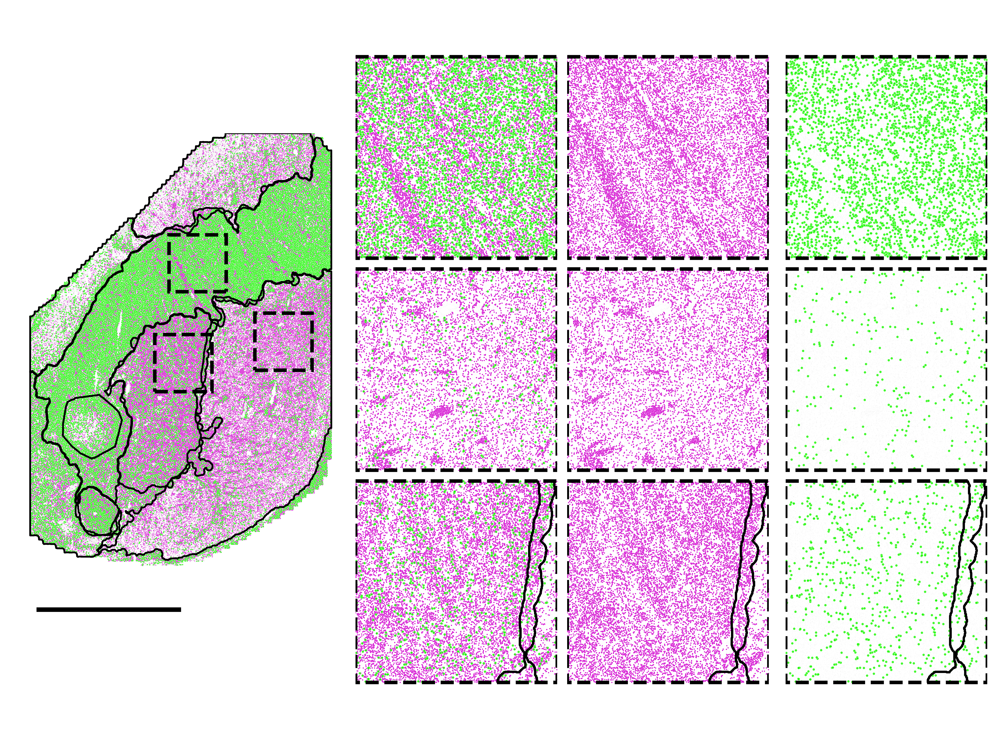

In [19]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 

nobox = False

rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
# backgd_sz = {'Donor_1311_posterior':0.025,'Donor_2427_anterior':0.05,'Donor_2427_posterior':0.03,'Donor_3924_anterior':0.05}
backgd_sz = {'Donor_1311_posterior':0.005,'Donor_2724_anterior':0.005,'Donor_2724_posterior':0.005,'Donor_3924_anterior':0.005}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}


all_clusters_plot = ['Oligo OPALIN','Oligo PLEKHG1']
point_sz_map_cp = copy.deepcopy(point_sz_map)
point_sz_map_cp[all_clusters_plot[0]] = 3*point_sz_map_cp[all_clusters_plot[0]]
point_sz_map_cp[all_clusters_plot[-1]] = 3*point_sz_map_cp[all_clusters_plot[-1]]

fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
bbox = fig.get_tightbbox()
ax = None

samples = ['Donor_2724_posterior']
# samples = ['Donor_2427_posterior','Donor_1311_posterior']
figure_title = 'Oligo_OPALIN_PLEKHG1'
transformed_Xsample = {}
transformed_module_cnt = {}
transformed_striocnt = {}

for sampleIdx,sample in enumerate(samples):
    cond = adata.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = adata[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample])
    cnt = copy.deepcopy(sptial_module_dict[sample])
    strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
    
    for label_ in cnt:
        if isinstance(cnt[label_],list):
            for i in range(len(cnt[label_])):
                cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
        else:   
            cnt[label_] = rotate(cnt[label_],rot_deg[sample])
    for idx in range(len(strio_cnt)):
        strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

    if reverse_coord[sample]:
        X_sample = X_sample[:,::-1]
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = cnt[label_][i][:,::-1]
            else:
                cnt[label_] = cnt[label_][:,::-1]
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = strio_cnt[idx][:,::-1]

    adata.obs.loc[cond,['x','y']] = X_sample.copy()
    # save the transformations 

    transformed_Xsample[sample] = X_sample.copy()
    transformed_module_cnt[sample] = copy.deepcopy(cnt)
    transformed_striocnt[sample] = copy.deepcopy(strio_cnt)


    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    if ax != None:
        bbox = ax.get_position()
    dx = dx/figsize_scale
    dy = dy/figsize_scale
    # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
    dx_frac = dx/fig.get_figwidth()
    dy_frac = dy/fig.get_figheight()
    width_gap = 1
    if sampleIdx < 2:
        width_gap = 0.9
    elif sampleIdx < 3:
        width_gap = 0.95

    ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
    plot_cluster_scdata(adata[cond],cluster_cmap,all_clusters = all_clusters_plot,clusters = all_clusters_plot,bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map_cp, transpose=1,flipx=1,flipy=1,hue_input = 'Group_name' , ax = ax,use_seaborn = True,show_title = False )
    
    # add the outregion outlines 
    for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
        if label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 1, c = 'k')
            else:
                ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 1, c = 'k')
    # add the striosome contour outline
    # for cnt in strio_cnt:
    #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

    # Set the axis limits 
    xmax, ymax = X_sample.max(axis=0)
    xmin, ymin = X_sample.min(axis=0)
    # ax.set_xlim([xmin,xmax])
    ax.set_ylim([ymin,ymax + 3500])
    # add scale bar
    # add scale bar
    if sample == 'Donor_2724_anterior':
        scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
    else:    
        scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
    ax.add_patch(scalebar)

    # put zoom-in box on the spatial plot 
    if sample == 'Donor_3924_anterior':
        zoom_bbox = patches.Rectangle([-10000, 10000],11000,-11000,color  ='k', fill = False,lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox)
    else: # if sample == 'Donor_2724_anterior':
        # this is in the internal-capasule 
        zoom_bbox_1 = patches.Rectangle([3000,-6000],-4000,-4000,color  ='k', fill = False, lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox_1)
        # this is in the pu
        zoom_bbox_2 = patches.Rectangle([5000,-500],4000,-4000,color  ='k', fill = False, lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox_2)
        # this is in the GPe
        zoom_bbox_3 = patches.Rectangle([-2000,1000],4000,-4000,color  ='k', fill = False, lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox_3)

    if invert_xaxis[sample]:
        ax.invert_xaxis()
    
    if invert_yaxis[sample]:
        ax.invert_yaxis()
    # ax.set_axis_on()
    # add axes for zoomin view 
    if True:
        # have 6 zoom in panels
        if sampleIdx == len(samples) - 1:
            bbox = ax.get_position()
            # Top row
            zoom1_ax = fig.add_axes([bbox.xmin + 1.02*bbox.width,bbox.ymin + 0.65*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
            zoom2_ax = fig.add_axes([bbox.xmin + 1.65*bbox.width, bbox.ymin + 0.65*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
            zoom3_ax = fig.add_axes([bbox.xmin + 2.30*bbox.width, bbox.ymin + 0.65*bbox.height, 0.6*bbox.width, 0.6*bbox.height])

            # middle row
            zoom4_ax = fig.add_axes([bbox.xmin + 1.02*bbox.width,bbox.ymin + 0.21*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
            zoom5_ax = fig.add_axes([bbox.xmin + 1.65*bbox.width, bbox.ymin + 0.21*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
            zoom6_ax = fig.add_axes([bbox.xmin + 2.30*bbox.width, bbox.ymin + 0.21*bbox.height, 0.6*bbox.width, 0.6*bbox.height])

            # bottom row
            zoom7_ax = fig.add_axes([bbox.xmin + 1.02*bbox.width,bbox.ymin - 0.23*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
            zoom8_ax = fig.add_axes([bbox.xmin + 1.65*bbox.width, bbox.ymin - 0.23*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
            zoom9_ax = fig.add_axes([bbox.xmin + 2.30*bbox.width, bbox.ymin - 0.23*bbox.height, 0.6*bbox.width, 0.6*bbox.height])
            
            
            # Plot the zoom-in data 
            zoom_ax_set = {0: [zoom1_ax, zoom2_ax, zoom3_ax], 1:[zoom4_ax, zoom5_ax, zoom6_ax],2: [zoom7_ax, zoom8_ax, zoom9_ax] }
            for bbox_idx,bbox_ in enumerate([zoom_bbox_1, zoom_bbox_2,zoom_bbox_3]):
                # get the limit 
                X_lim,Y_lim = np.array(bbox_.get_bbox()).T
                xmin,xmax = tuple(X_lim) if X_lim[0] < X_lim[1] else tuple(X_lim[::-1])
                ymin,ymax = tuple(Y_lim) if Y_lim[0] < Y_lim[1] else tuple(Y_lim[::-1])

                sample_cond = adata.obs['samples'] == sample
                X_sample = transformed_Xsample[sample].copy()
                cond1 = (X_sample[:,0] > xmin) & (X_sample[:,0] < xmax)
                cond2 = (X_sample[:,1] > ymin) & (X_sample[:,1]  < ymax)
                # increase the size of the point 
                point_sz_map_cp = copy.deepcopy(point_sz_map)
                for clst in all_clusters_plot:
                    point_sz_map_cp[clst] = 10*point_sz_map_cp[clst]

                for ax_,clst_set in zip(zoom_ax_set[bbox_idx],[all_clusters_plot,all_clusters_plot[0],all_clusters_plot[-1]]):
                    clst_set = [clst_set] if not isinstance(clst_set, list) else clst_set
                    plot_cluster_scdata(adata[sample_cond][cond1 & cond2],cluster_cmap,all_clusters = clst_set,clusters = clst_set,bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map_cp, transpose=1,flipx=1,flipy=1,hue_input = 'Group_name' , ax = ax_,use_seaborn = True,show_title = False )
                    # add the box ontop to highlight the bbox
                    zbbox = patches.Rectangle(list(X_sample[cond1 & cond2].min(axis=0)),*tuple(np.ptp(X_sample[cond1 & cond2],axis = 0)),color  ='k', fill = False, lw = 2, ls = '--')
                    if not nobox:
                        ax_.add_patch(zbbox)

                    # add the outregion outlines 
                    cnt = transformed_module_cnt[sample]
                    for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
                        if label_ in cnt:
                            if isinstance(cnt[label_],list):
                                for i in range(len(cnt[label_])):
                                    cnt_cond1 = (cnt[label_][i][:,0] > xmin) & (cnt[label_][i][:,0] < xmax)
                                    cnt_cond2 = (cnt[label_][i][:,1] > ymin) & (cnt[label_][i][:,1]  < ymax)
                                    ax_.scatter(cnt[label_][i][cond1 & cond2,0],cnt[label_][i][cond1 & cond2,1], s = 1e-1, c = 'k')
                            else:
                                cnt_cond1 = (cnt[label_][:,0] > xmin) & (cnt[label_][:,0] < xmax)
                                cnt_cond2 = (cnt[label_][:,1] > ymin) & (cnt[label_][:,1]  < ymax)
                                ax_.scatter(cnt[label_][cnt_cond1 & cnt_cond2,0],cnt[label_][cnt_cond1 & cnt_cond2,1], s = 1e-1, c = 'k')

                    if invert_xaxis[sample]:
                        ax_.invert_xaxis()
                    if invert_yaxis[sample]:
                        ax_.invert_yaxis()


        # ax.set_aspect('equal', adjustable ='datalim')
        if False:#sampleIdx == 0:
            # create axis to put the title and text 
            bbox = ax.get_position()
            legend_ax = fig.add_axes([bbox.xmin + 0.3*bbox.width, bbox.ymin + 1.03*bbox.height, 3.5*bbox.width, 0.3*bbox.height])
            # add circle patche and text for the 3 cell types 
            for clst_i, clst in enumerate(['STRd D1 Striosome MSN','STRd D1 Matrix MSN','STRv D1 MSN']):
                yfactor = -0.5 if clst == 'STRv D1 MSN' else 0
                xfactor=  1 if clst == 'STRv D1 MSN' else 0
                color_rec = patches.Circle([-4.5 + 5*(clst_i - xfactor),0.72 + yfactor],0.2, color = cluster_cmap[clst])
                legend_ax.add_patch(color_rec)
                legend_ax.text((-4.5 + 5*(clst_i-xfactor)) + 0.3, 0.72 + yfactor, f'{clst}', fontsize = 25, color = 'k', va = 'center')
            legend_ax.set_aspect('equal',adjustable='datalim')
            # legend_ax.set_ylim(-1.3,1)
            legend_ax.set_axis_off()
    
file_name = '2724_posterior_Oligo_OPALIN_PLEKHG1'
if nobox:
    file_name = file_name + '_nobox'
    
plt.savefig(r'./figures/figure4/main_nonneuronalFig' + os.sep + file_name + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/figure4/main_nonneuronalFig' + os.sep + file_name + '.tif',bbox_inches = 'tight')

plt.show()

### 2. DEG between 'Oligo OPALIN','Oligo PLEKHG1'

- First identify genes that are specific to astrocytes
- Perform DEG between Oligo and the rest of cell-types
- subset to oligo specific genes and run DEG between Oligo OPALIN and Oligo PLEKHG1, so see what are the oligo related genes that are specific to these cell types. 

- QC: filter outlier cells

In [11]:
# Remove QC terms concatenated from previous data 
for col in ['n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes']:
    del adata.obs[col]

In [12]:
# Calculate qc metrics 
sc.pp.calculate_qc_metrics(adata,inplace=True)

# QC by count 
totalct_1pp = np.percentile(adata.obs['total_counts'], 1)
totalct_99pp = np.percentile(adata.obs['total_counts'], 99)
totalct_cond = (adata.obs['total_counts'] > totalct_1pp) & (adata.obs['total_counts'] < totalct_99pp)
# QC by volume
Vol_1pp = np.percentile(adata.obs['volm'], 1)
Vol_99pp = np.percentile(adata.obs['volm'], 99)
vol_cond = (adata.obs['volm'] > Vol_1pp) & (adata.obs['volm'] < Vol_99pp)
adata = adata[vol_cond & totalct_cond].copy()
adata

AnnData object with n_obs × n_vars = 3124774 × 673
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    obsm: 'X_raw', 'X_spatial', 'X_spatial_rotated', 'X_umap', 'X_pca'
    layers: 'X_raw'

- Normalize the data 

In [13]:
# Normalize 
med_volm = np.median(adata.obs['volm'])
temp = adata.X.astype('float').copy()
temp /= adata.obs['volm'].values[:,np.newaxis]
temp *= med_volm
adata.X  = temp
# adata.layer['volm_normed_count'] = temp.copy() # keep copy of the volume normalized count, this is basically RNA-density 

target_sum  = np.median(np.array(adata.X.sum(axis=-1)))
sc.pp.normalize_total(adata, target_sum=target_sum)
sc.pp.log1p(adata)

- Run DEG on individual samples

In [14]:
from tqdm import tqdm 
Oligo_markers = []
for sample in tqdm(np.unique(adata.obs['samples']), desc = 'running DEGs'):
    keep = adata.obs['samples'].isin([sample])
    subadata = adata[keep].copy()
    sc.tl.rank_genes_groups(subadata, 'Subclass_name',use_raw = False, method = 'wilcoxon')
    markers = sc.get.rank_genes_groups_df(subadata, 'Oligodendrocyte')
    markers = markers[(markers.pvals_adj < 0.05) & (markers.logfoldchanges > 0.5)].names.values
    Oligo_markers += [np.unique(markers)]
    del subadata
Oligo_markers = np.hstack(markers)

running DEGs:   0%|          | 0/4 [00:00<?, ?it/s]/home/exx/.conda/envs/3D_Hippo_MERFISH_env/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:456: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/exx/.conda/envs/3D_Hippo_MERFISH_env/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/exx/.conda/envs/3D_Hippo_MERFISH_env/l

- Subset the data to Oligo-OPALIN and Oligo-PLEKHG1  ,and oligodendrocyte related genes

In [15]:
np.unique(adata.obs['Group_name'])

array(['AMY-SLEA-BNST D1 GABA', 'AMY-SLEA-BNST GABA', 'Astrocyte',
       'B cells', 'BAM', 'BF SKOR1 Glut', 'COP', 'Endo', 'Ependymal',
       'GPe MEIS2-SOX6 GABA', 'GPe SOX6-CTXND1 GABA',
       'GPe-NDB-SI LHX6-LHX8-GBX1 GABA', 'GPi Core', 'GPi Shell',
       'GPin-BF Cholinergic GABA', 'ImAstro', 'ImOligo',
       'LAMP5-CXCL14 GABA', 'LAMP5-LHX6 GABA', 'Microglia', 'Monocyte',
       'OB Dopa-GABA', 'OB FRMD7 GABA', 'OPC', 'OT D1 ICj',
       'Oligo OPALIN', 'Oligo PLEKHG1', 'Pericyte', 'SMC', 'SN EBF2 GABA',
       'SN GATA3-PVALB GABA', 'SN SEMA5A GABA', 'SN SOX6 Dopa',
       'SN-VTR CALB1 Dopa', 'SN-VTR GAD2 Dopa',
       'SN-VTR-HTH GATA3-TCF7L2 GABA', 'STH PVALB-PITX2 Glut',
       'STR Cholinergic GABA', 'STR D1D2 Hybrid MSN',
       'STR FS PTHLH-PVALB GABA', 'STR LYPD6-RSPO2 GABA',
       'STR SST-ADARB2 GABA', 'STR SST-CHODL GABA', 'STR SST-RSPO2 GABA',
       'STR TAC3-PLPP4 GABA', 'STR-BF TAC3-PLPP4-LHX8 GABA',
       'STRd Cholinergic GABA', 'STRd D1 Matrix MSN',
   

In [16]:
keep = adata.obs['Group_name'].isin(['Oligo OPALIN', 'Oligo PLEKHG1']) 
adata_oligo = adata[keep].copy()
adata_oligo = adata_oligo[:,Oligo_markers].copy()
adata_oligo

AnnData object with n_obs × n_vars = 1078381 × 91
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'
    obsm: 'X_raw', 'X_spatial', 'X_spatial_rotated', 'X_umap', 'X_pca'
    layers: 'X_raw'

- QC the subsetted data 

In [17]:
adata_oligo.X = adata_oligo.layers['X_raw'].copy()

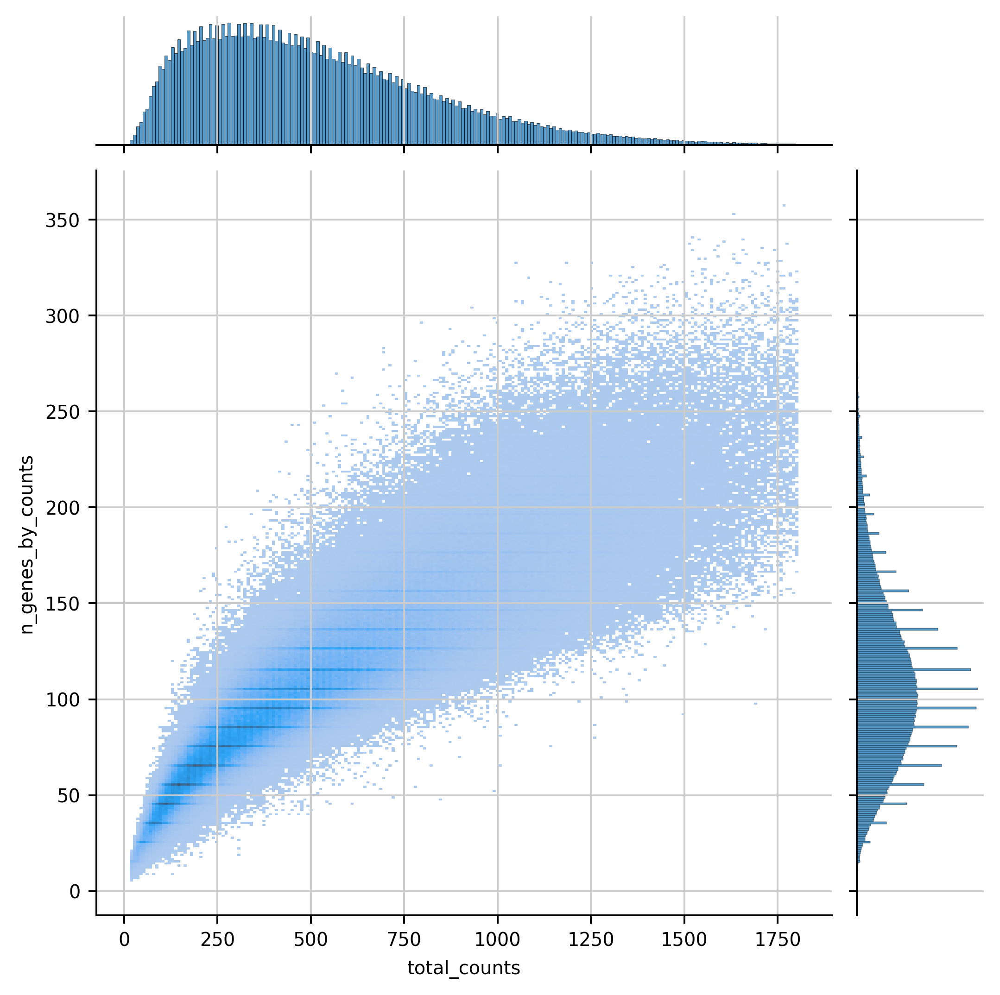

In [18]:
sns.jointplot(adata_oligo.obs, x = 'total_counts', y = 'n_genes_by_counts',kind="hist")

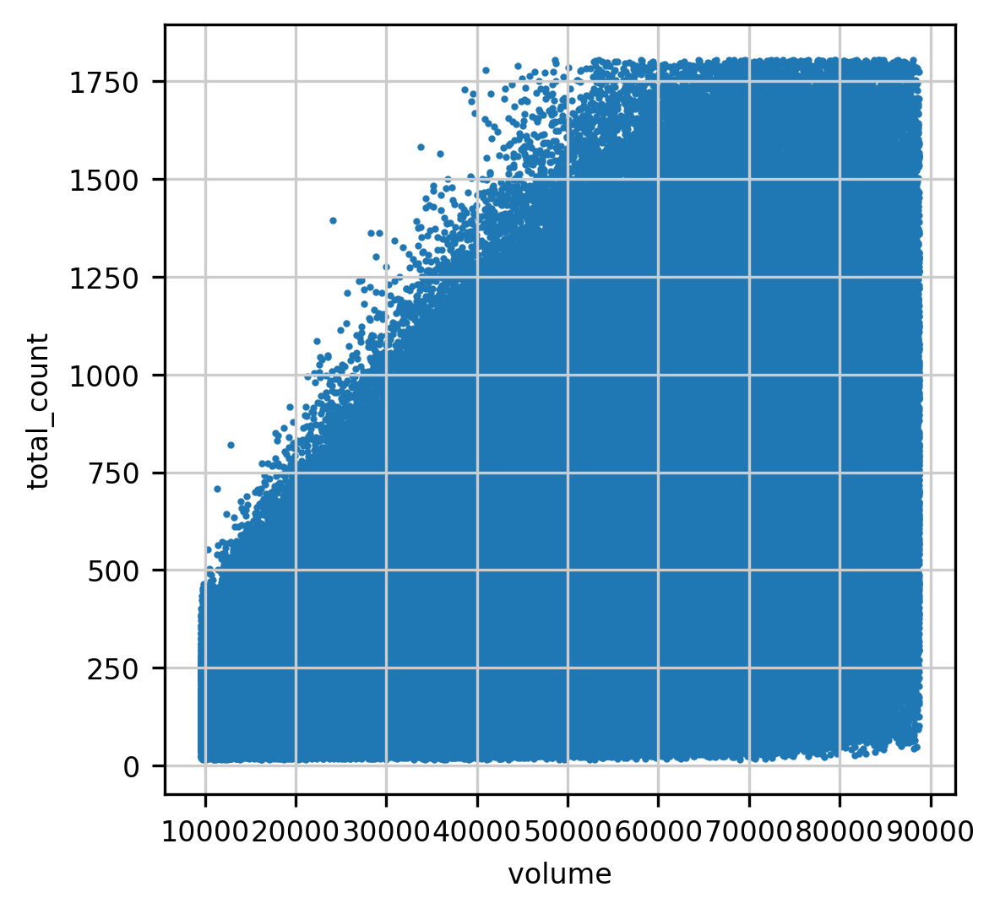

In [19]:

fig,ax = plt.subplots(1,1, dpi = 150)
ax.scatter(adata_oligo.obs['volm'], adata_oligo.obs['total_counts'],s = 1)
ax.set_xlabel('volume')
ax.set_ylabel('total_count')
plt.show()

- QC based on volume and total count 

In [20]:
# QC based on volume
oligo_1pp_vol = adata_oligo.obs['volm'] > np.percentile(adata_oligo.obs['volm'],2)
oligo_99pp_vol = adata_oligo.obs['volm'] < np.percentile(adata_oligo.obs['volm'],98)
oligo_volm_cond = oligo_1pp_vol & oligo_99pp_vol
print(f'{oligo_volm_cond.sum()}/{oligo_1pp_vol.size} cells passed volume QC')

# QC based on count
adata_oligo.obs['total_counts'] = adata_oligo.X.sum(axis=-1)
oligo_1pp_totct = adata_oligo.obs['total_counts'] > np.percentile(adata_oligo.obs['total_counts'],2)
oligo_99pp_totct = adata_oligo.obs['total_counts'] < np.percentile(adata_oligo.obs['total_counts'],98)
oligo_totct_cond = oligo_1pp_totct & oligo_99pp_totct
print(f'{oligo_totct_cond.sum()}/{oligo_totct_cond.size} cells passed count QC')
# QC based on transcript density 
count_vol_ratio = np.percentile(adata_oligo.obs['total_counts']/adata_oligo.obs['volm'],20)
count_min = np.percentile(adata_oligo.obs['total_counts'],2) # min-count 
RNAdensity_cond = np.greater_equal(adata_oligo.obs['total_counts'],count_vol_ratio*adata_oligo.obs['volm'] + count_min )
print(f'{RNAdensity_cond.sum()}/{RNAdensity_cond.size} passed QC...')
# Filter based on Label transfer 
labelTransfer_cond = (adata_oligo.obs['Group_bootstrapping_probability'] > 0.6) & (adata_oligo.obs['Class_bootstrapping_probability'] > 0.8)
print(f'{labelTransfer_cond.sum()}/{labelTransfer_cond.size} passed QC...')


final_cond = oligo_volm_cond & oligo_totct_cond & RNAdensity_cond & labelTransfer_cond
print(f'{final_cond.sum()}/{final_cond.size} passed final QC...')

1035243/1078381 cells passed volume QC
1035158/1078381 cells passed count QC
740344/1078381 passed QC...
659301/1078381 passed QC...
481575/1078381 passed final QC...


In [21]:
adata_oligo = adata_oligo[final_cond].copy()
adata_oligo

AnnData object with n_obs × n_vars = 481575 × 91
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'
    obsm: 'X_raw', 'X_spatial', 'X_spatial_rotated', 'X_umap', 'X_pca'
    layers: 'X_raw'

- Normalize the subsetted data 

In [22]:
%%time
# normalize by volume 
med_volm = np.median(adata_oligo.obs['volm'])
temp = adata_oligo.X.astype('float').copy()
temp /= adata_oligo.obs['volm'].values[:,np.newaxis]
temp *= med_volm
adata_oligo.X  = temp
# Normalize by count 
target_sum  = np.median(np.array(adata_oligo.X.sum(axis=-1)))
sc.pp.normalize_total(adata_oligo, target_sum=target_sum)
sc.pp.log1p(adata_oligo)
# keep record of the log-normalized counts
adata_oligo.layers['log_count'] =  adata_oligo.X.copy()

CPU times: user 435 ms, sys: 68.9 ms, total: 504 ms
Wall time: 502 ms


- Run DEG

In [23]:
%%time
sc.tl.rank_genes_groups(adata_oligo, 'Group_name',use_raw = False, method = 'wilcoxon')

CPU times: user 5.32 s, sys: 53.6 ms, total: 5.38 s
Wall time: 1.04 s


In [24]:
np.unique(adata_oligo.obs['Group_name'])

array(['Oligo OPALIN', 'Oligo PLEKHG1'], dtype=object)

In [25]:
marker_gns = sc.get.rank_genes_groups_df(adata_oligo,None)
marker_gns

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,Oligo OPALIN,OPALIN,372.320801,3.567011,0.0,0.0
1,Oligo OPALIN,PTGDS,188.530701,0.895867,0.0,0.0
2,Oligo OPALIN,PTK2,186.504196,0.702178,0.0,0.0
3,Oligo OPALIN,HHIP,172.839752,1.526050,0.0,0.0
4,Oligo OPALIN,LPAR1,170.580582,0.886638,0.0,0.0
...,...,...,...,...,...,...
177,Oligo PLEKHG1,LPAR1,-170.580582,-0.886638,0.0,0.0
178,Oligo PLEKHG1,HHIP,-172.839752,-1.526050,0.0,0.0
179,Oligo PLEKHG1,PTK2,-186.504196,-0.702178,0.0,0.0
180,Oligo PLEKHG1,PTGDS,-188.530701,-0.895867,0.0,0.0


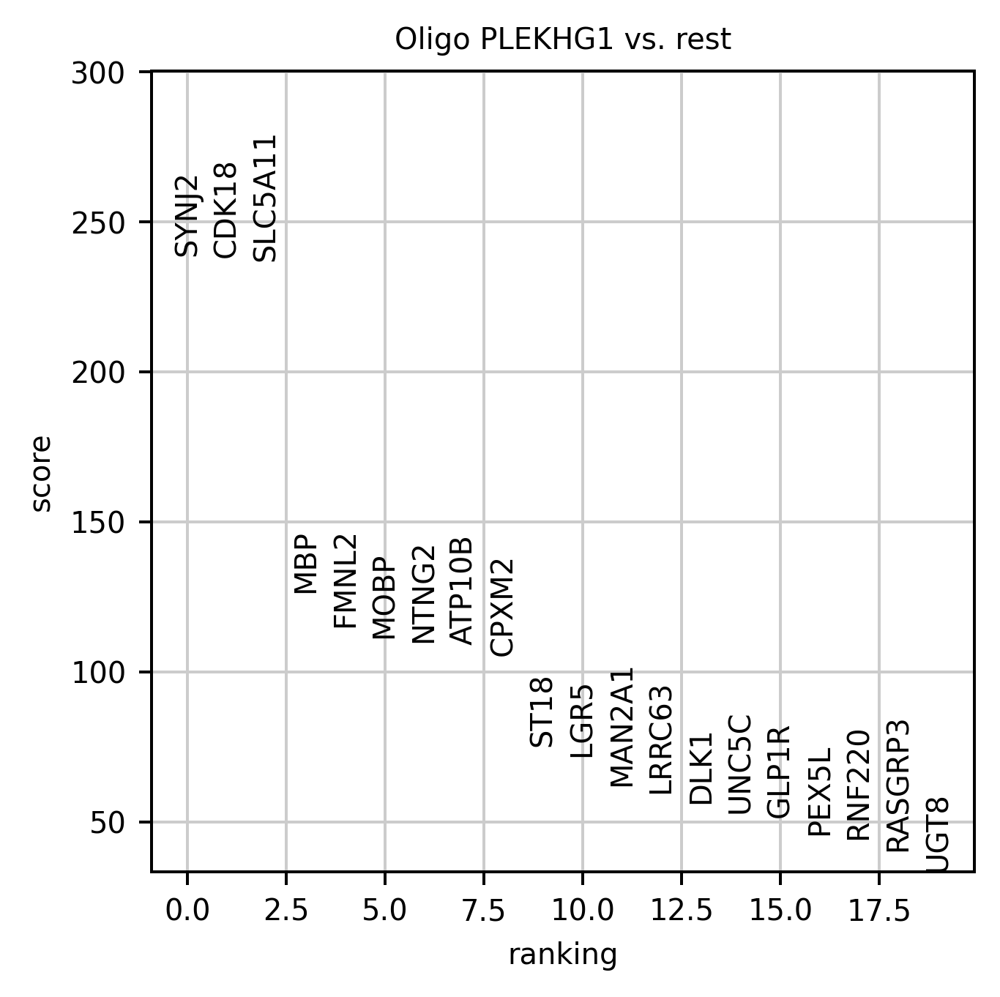

In [26]:
# sc.pl.rank_genes_groups(adata_oligo,groups = 'Oligo OPALIN',n_genes= 5)
sc.pl.rank_genes_groups(adata_oligo, groups = ['Oligo PLEKHG1'],n_genes= 20)

- Plot the heatmap

1. Get the log1p for top marker genes

In [27]:
np.unique(adata_oligo.obs['Group_name'])

array(['Oligo OPALIN', 'Oligo PLEKHG1'], dtype=object)

In [28]:
markerGn_exp = []
top_markerGns = []
# for LGE_subtype in np.unique(marker.group):
unique_celltype = ['Oligo OPALIN', 'Oligo PLEKHG1']
for oligo_subtype in unique_celltype:

    # get the top 5 genes for the subtype 
    top_gns = marker_gns[marker_gns.group == oligo_subtype].names[:10].values.tolist()
    # make sure the genes are not repeated 
    if len(top_markerGns):
        top_gns = list(set(top_gns).difference(top_markerGns))
    top_markerGns += top_gns
    markerGn_exp += [adata_oligo[:,top_gns].X.copy()]
markerGn_exp   = np.column_stack(markerGn_exp).T

Now z-score the log1p expression of each gene across cells

In [29]:
mu = np.mean(markerGn_exp, axis = -1, keepdims = True)
std = np.std(markerGn_exp, axis = -1, keepdims = True)

# if a genes  show std  equal to 0, set it to inf so that it does not contribute 
std = np.where(std < 1e-9, np.inf, std)

markerGn_exp_zscore = (markerGn_exp - mu)/std
markerGn_exp_zscore.shape

(20, 481575)

- Now sort the cells so that cells of the same cell type are grouped together.

In [30]:
unique_celltype

['Oligo OPALIN', 'Oligo PLEKHG1']

In [31]:
olgio_celltypes_2_num = {oligo_type:i for i,oligo_type in enumerate(unique_celltype)}
Group_names = np.array(adata_oligo.obs['Group_name'].values)
Group_names_ID = np.array([olgio_celltypes_2_num[nm] for nm in Group_names])
cell_sortIDX = np.argsort(Group_names_ID)
markerGn_exp_zscore = markerGn_exp_zscore[:,cell_sortIDX].copy()
markerGn_exp_zscore.shape

(20, 481575)

- Now sort the genes so that genes that are expressed most in cells of the same cell type are grouped together

In [32]:
from tqdm import tqdm 
gn_argmaxidx = []
for i,gn in tqdm(enumerate(top_markerGns)):
    df = pd.DataFrame(
        np.column_stack([markerGn_exp_zscore[i,:], Group_names_ID[cell_sortIDX]]),
        columns = [f'{gn}','celltype_ID']
    )
    df = df.groupby('celltype_ID').mean()
    celltypeID = np.array(df.index).astype(int)
    meanexp = df.values.ravel()
    gn_argmaxidx += [celltypeID[np.argmax(meanexp)]]
    

20it [00:00, 140.94it/s]


In [33]:
gn_sortidx = np.argsort(gn_argmaxidx)
markerGn_exp_zscore = markerGn_exp_zscore[gn_sortidx,:].copy()

In [34]:
top_markerGns = np.array(top_markerGns)[gn_sortidx]
top_markerGns

array(['OPALIN', 'BCAS1', 'MATN2', 'KCNK10', 'ERBIN', 'CDH23', 'HHIP',
       'PTK2', 'PTGDS', 'LPAR1', 'MOBP', 'NTNG2', 'SLC5A11', 'ATP10B',
       'ST18', 'MBP', 'CDK18', 'CPXM2', 'FMNL2', 'SYNJ2'], dtype='<U7')

- Plot the heatmap

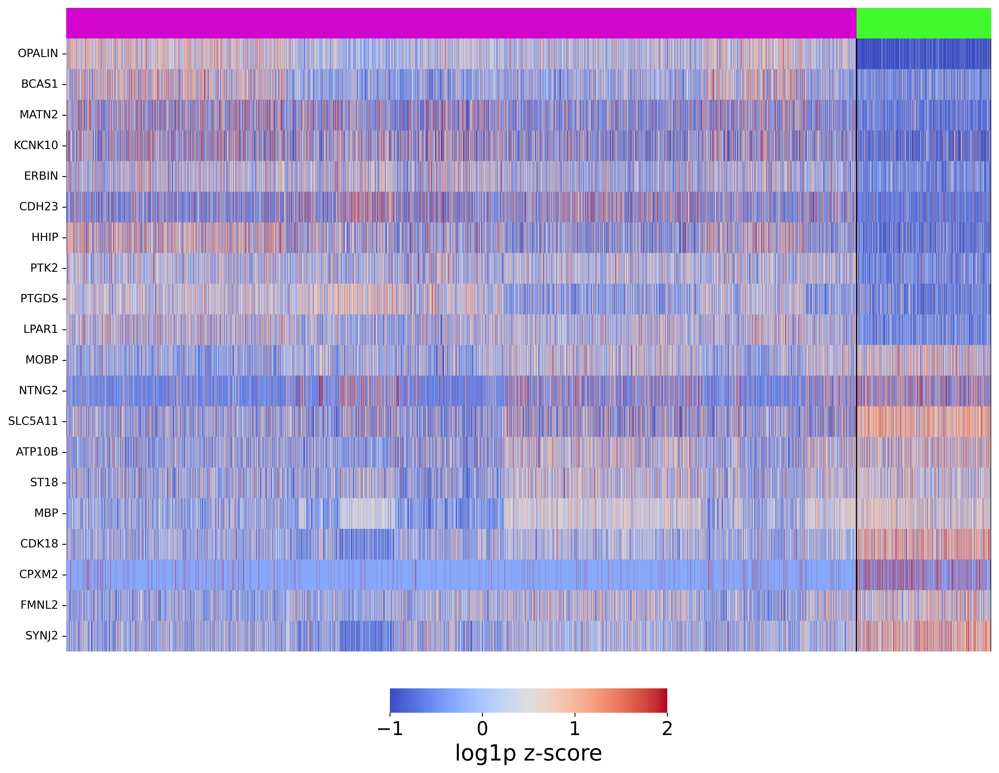

In [35]:
import matplotlib as mpl
import matplotlib.patches as patch
import matplotlib.pyplot as plt
import seaborn as sns
import os

mpl.rcParams['font.size'] = 20

plt.style.use('default')

file_name = 'GP_subtypes_DEG_heatmap'

fig,ax = plt.subplots(1,1, figsize = (15,10), dpi = 300)

# axis for color bar 
# bbox = ax.get_position()
# ax_cbar = fig.add_axes([bbox.xmin + 1.05*bbox.width ,bbox.ymin + 0.3*bbox.height ,0.03*bbox.width,0.5*bbox.height])
bbox = ax.get_position()
ax_cbar = fig.add_axes([bbox.xmin + 0.35*bbox.width ,bbox.ymin - 0.1*bbox.height ,0.3*bbox.width,0.04*bbox.height])

     
sns.heatmap(
            markerGn_exp_zscore,
            xticklabels = False,
            yticklabels = top_markerGns,
            cmap = 'coolwarm',
            ax = ax,
            vmax = 2,
            vmin = -1,
            cbar_ax = ax_cbar,
            cbar_kws = {'orientation':'horizontal'}
            )

ax_cbar.set_xlabel('log1p z-score', fontdict={'fontsize': 20})

ax_cbar.tick_params('y',which='major',labelsize = 20)
ax_cbar.tick_params('x',which='major',labelsize = 17)

# cmap = ["#e6194B", "#3cb44b", "#ffe119", "#4363d8", "#f58231", "#911eb4", "#42d4f4", "#f032e6", "#bfef45",
#         "#fabed4", "#469990", "#dcbeff", "#9A6324", "#fffac8", "#800000", "#aaffc3", "#808000", "#ffd8b1",
#         "#000075", "#a9a9a9"]
# # add a lines and rectangular bars to indicate the cell types
Group_names_ID_sorted = Group_names_ID[cell_sortIDX]
end_pts = [np.where(Group_names_ID_sorted == idx)[0].max() for idx in np.unique(Group_names_ID_sorted) ]

for i,pt in enumerate(end_pts):
    ax.plot([pt,pt],[0,len(markerGn_exp_zscore)], lw = 1 , c = 'k')

bbox = ax.get_position()
ax1 = fig.add_axes([bbox.xmin,bbox.ymax,bbox.width,0.05*bbox.height])

# Pick color based on ordered clusters 
num_2_oligo_celltypes = {num:clst for clst,num in olgio_celltypes_2_num.items()}
sorted_clusters = [num_2_oligo_celltypes[ID] for ID in np.unique(Group_names_ID[cell_sortIDX])]

choices1 = [cluster_cmap[clst] for clst in sorted_clusters]
my_colors = tuple(list(choices1)) #('C0', 'C1', 'C2')
cmap_d2 = mpl.colors.LinearSegmentedColormap.from_list('', my_colors, len(my_colors))
sns.heatmap(
            Group_names_ID_sorted[np.newaxis,:],
            xticklabels = False,
            yticklabels = False,
            ax = ax1,
            cmap = cmap_d2,
            cbar = None,
            )


ax.yaxis.set_tick_params(labelsize=10.2)

# plt.savefig(r'./figures/GP_MainFigure' + os.sep + file_name + '.png',bbox_inches = 'tight')
# plt.savefig(r'./figures/GP_MainFigure' + os.sep + file_name + '.tif',bbox_inches = 'tight')

plt.show()

In [36]:
len(my_colors)

2

- Plot a Matrix plot: take the average of the log-zscored expression within each class.

In [37]:
unq_class = np.unique(Group_names_ID[cell_sortIDX])
unq_class

array([0, 1])

In [38]:
markerGn_exp_zscore.shape

(20, 481575)

In [39]:

markerGn_exp_zscore_avg = []
for class_idx in unq_class:
    keep = Group_names_ID[cell_sortIDX] == class_idx
    markerGn_exp_zscore_avg += [np.mean(markerGn_exp_zscore[:,keep],axis=-1,keepdims = True)] # gns x 1
markerGn_exp_zscore_avg  = np.column_stack(markerGn_exp_zscore_avg)
markerGn_exp_zscore_avg.shape

(20, 2)

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


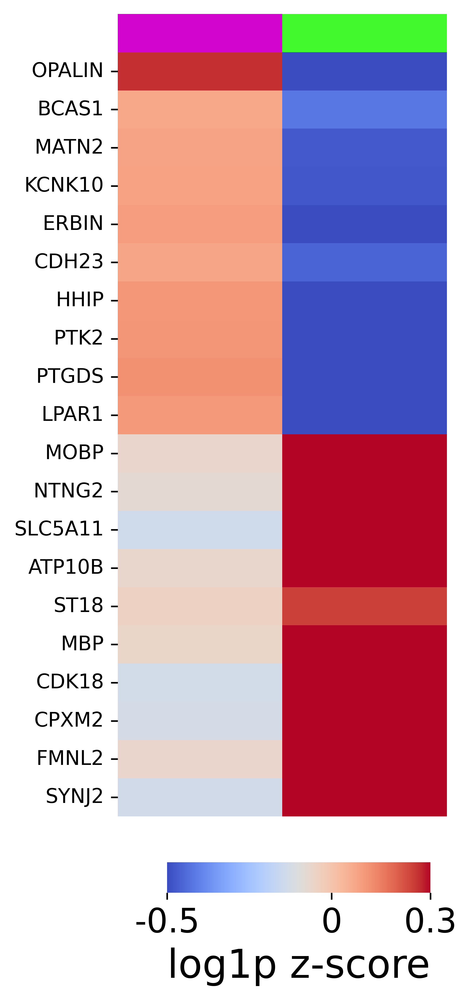

In [41]:
import matplotlib as mpl
import matplotlib.patches as patch
import matplotlib.pyplot as plt
import seaborn as sns
import os

mpl.rcParams['font.size'] = 20

plt.style.use('default')

file_name = 'Oligo_OPALIN_Oligo_PLEKHG1_subtypes_DEG_heatmap'

fig,ax = plt.subplots(1,1, figsize = (3,7), dpi = 300)

# axis for color bar 
# bbox = ax.get_position()
# ax_cbar = fig.add_axes([bbox.xmin + 1.05*bbox.width ,bbox.ymin + 0.3*bbox.height ,0.03*bbox.width,0.5*bbox.height])
bbox = ax.get_position()
ax_cbar = fig.add_axes([bbox.xmin + 0.15*bbox.width ,bbox.ymin - 0.1*bbox.height ,0.8*bbox.width,0.04*bbox.height])

    
sns.heatmap(
            markerGn_exp_zscore_avg,
            xticklabels = False,
            yticklabels = top_markerGns,
            cmap = 'coolwarm',
            ax = ax,
            vmax = 0.3,
            vmin = -0.5,
            cbar_ax = ax_cbar,
            cbar_kws = {'orientation':'horizontal'}
            )

ax_cbar.set_xticks([-0.5,0,0.3], labels=[-0.5,0,0.3])
ax_cbar.set_xlabel('log1p z-score', fontdict={'fontsize': 20})
ax_cbar.tick_params('y',which='major',labelsize = 20)
ax_cbar.tick_params('x',which='major',labelsize = 17)


        
# cmap = ["#e6194B", "#3cb44b", "#ffe119", "#4363d8", "#f58231", "#911eb4", "#42d4f4", "#f032e6", "#bfef45",
#         "#fabed4", "#469990", "#dcbeff", "#9A6324", "#fffac8", "#800000", "#aaffc3", "#808000", "#ffd8b1",
#         "#000075", "#a9a9a9"]

# # # add a lines and rectangular bars to indicate the cell types
# Group_names_ID_sorted = Group_names_ID[cell_sortIDX]
# end_pts = [np.where(Group_names_ID_sorted == idx)[0].max() for idx in np.unique(Group_names_ID_sorted) ]

# for i,pt in enumerate(end_pts):
#     ax.plot([pt,pt],[0,len(markerGn_exp_zscore)], lw = 1 , c = 'k')

bbox = ax.get_position()
ax1 = fig.add_axes([bbox.xmin,bbox.ymax,bbox.width,0.05*bbox.height])

# Pick color based on ordered clusters 
num_2_oligo_celltypes = {num:clst for clst,num in olgio_celltypes_2_num.items()}
sorted_clusters = [num_2_oligo_celltypes[ID] for ID in unq_class]

choices1 = [cluster_cmap[clst] for clst in sorted_clusters]
my_colors = tuple(list(choices1)) #('C0', 'C1', 'C2')
cmap_d2 = mpl.colors.LinearSegmentedColormap.from_list('', my_colors, len(my_colors))
sns.heatmap(
            unq_class[np.newaxis,:],
            xticklabels = False,
            yticklabels = False,
            ax = ax1,
            cmap = cmap_d2,
            cbar = None,
            )


ax.yaxis.set_tick_params(labelsize=10.2)

plt.savefig(r'./figures/Figure4/main_nonneuronalFig' + os.sep + file_name + '_updated.png',bbox_inches = 'tight')
plt.savefig(r'./figures/Figure4/main_nonneuronalFig' + os.sep + file_name + '_updated.tif',bbox_inches = 'tight')
plt.savefig(r'./figures/Figure4/main_nonneuronalFig' + os.sep + file_name + '_updated.eps',bbox_inches = 'tight')

plt.show()